In [1]:
import matplotlib as plt
import matplotlib.pyplot as plt2
from sklearn import datasets
from sklearn.model_selection import train_test_split
import pandas as pd
import seaborn as sns
import numpy as np

from sklearn import preprocessing
from sklearn.metrics import silhouette_score
from scipy.cluster.hierarchy import dendrogram, linkage
import scipy.cluster.hierarchy as shc
from sklearn.decomposition import PCA

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

In [2]:
raw_data = pd.read_csv("customer_segmentation.csv")

In [3]:
raw_data.describe()

,ID,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
count,2240.000000,2240.000000,2216.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,...,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.0,2240.0,2240.000000
mean,5592.159821,1968.805804,52247.251354,0.444196,0.506250,49.109375,303.935714,26.302232,166.950000,37.525446,...,5.316518,0.072768,0.074554,0.072768,0.064286,0.013393,0.009375,3.0,11.0,0.149107
std,3246.662198,11.984069,25173.076661,0.538398,0.544538,28.962453,336.597393,39.773434,225.715373,54.628979,...,2.426645,0.259813,0.262728,0.259813,0.245316,0.114976,0.096391,0.0,0.0,0.356274
min,0.000000,1893.000000,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
25%,2828.250000,1959.000000,35303.000000,0.000000,0.000000,24.000000,23.750000,1.000000,16.000000,3.000000,...,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
50%,5458.500000,1970.000000,51381.500000,0.000000,0.000000,49.000000,173.500000,8.000000,67.000000,12.000000,...,6.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
75%,8427.750000,1977.000000,68522.000000,1.000000,1.000000,74.000000,504.250000,33.000000,232.000000,50.000000,...,7.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
max,11191.000000,1996.000000,666666.000000,2.000000,2.000000,99.000000,1493.000000,199.000000,1725.000000,259.000000,...,20.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,3.0,11.0,1.000000


In [4]:
raw_data.index[raw_data['Income']==666666.0].tolist()

[2233]

In [5]:
raw_data = raw_data.drop(2233)

In [6]:
raw_data = raw_data.drop(columns=['ID', 'Z_CostContact', 'Z_Revenue'])

In [7]:
raw_data.describe()

,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,...,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response
count,2239.000000,2215.000000,2239.000000,2239.000000,2239.000000,2239.000000,2239.000000,2239.000000,2239.000000,2239.000000,...,2239.000000,2239.000000,2239.000000,2239.000000,2239.000000,2239.000000,2239.000000,2239.000000,2239.000000,2239.000000
mean,1968.802144,51969.861400,0.443948,0.506476,49.121036,304.067441,26.307727,167.016525,37.538633,27.074587,...,2.662796,5.791425,5.316213,0.072800,0.074587,0.072800,0.064314,0.013399,0.009379,0.149174
std,11.985494,21526.320095,0.538390,0.544555,28.963662,336.614830,39.781468,225.743829,54.637617,41.286043,...,2.923542,3.251149,2.427144,0.259867,0.262782,0.259867,0.245367,0.115001,0.096412,0.356339
min,1893.000000,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1959.000000,35284.000000,0.000000,0.000000,24.000000,24.000000,1.000000,16.000000,3.000000,1.000000,...,0.000000,3.000000,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,1970.000000,51373.000000,0.000000,0.000000,49.000000,174.000000,8.000000,67.000000,12.000000,8.000000,...,2.000000,5.000000,6.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,1977.000000,68487.000000,1.000000,1.000000,74.000000,504.500000,33.000000,232.000000,50.000000,33.000000,...,4.000000,8.000000,7.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,1996.000000,162397.000000,2.000000,2.000000,99.000000,1493.000000,199.000000,1725.000000,259.000000,263.000000,...,28.000000,13.000000,20.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [8]:
raw_data.columns

Index(['Year_Birth', 'Education', 'Marital_Status', 'Income', 'Kidhome',
       'Teenhome', 'Dt_Customer', 'Recency', 'MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Complain', 'Response'],
      dtype='object')

In [9]:
raw_data.shape

(2239, 26)

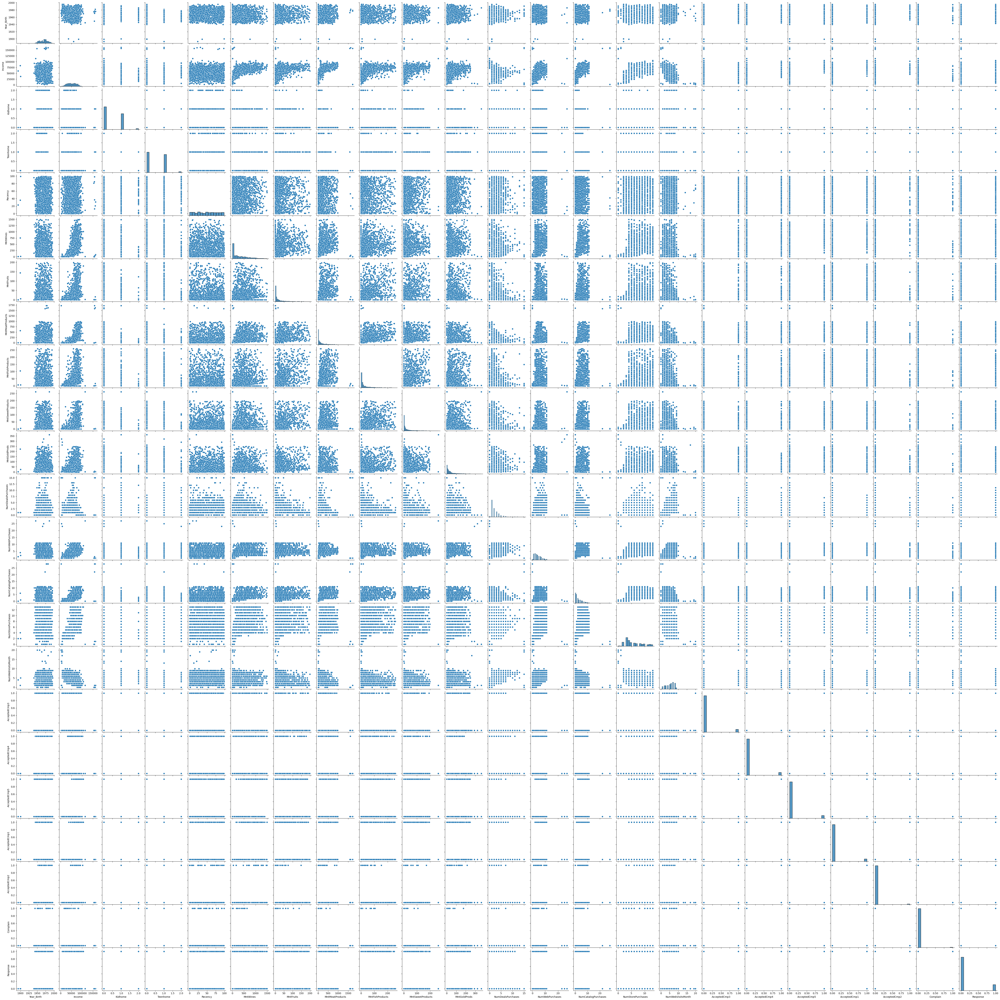

In [10]:
sns.pairplot(data=raw_data)

In [11]:
data_minus_75_percent_0 = raw_data.drop(columns=['AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1', 'AcceptedCmp2', 'Complain', 'Response'])

In [12]:
data_minus_75_percent_0.describe()

,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth
count,2239.000000,2215.000000,2239.000000,2239.000000,2239.000000,2239.000000,2239.000000,2239.000000,2239.000000,2239.000000,2239.000000,2239.000000,2239.000000,2239.000000,2239.000000,2239.000000
mean,1968.802144,51969.861400,0.443948,0.506476,49.121036,304.067441,26.307727,167.016525,37.538633,27.074587,44.036177,2.324252,4.085306,2.662796,5.791425,5.316213
std,11.985494,21526.320095,0.538390,0.544555,28.963662,336.614830,39.781468,225.743829,54.637617,41.286043,52.174700,1.932345,2.779240,2.923542,3.251149,2.427144
min,1893.000000,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1959.000000,35284.000000,0.000000,0.000000,24.000000,24.000000,1.000000,16.000000,3.000000,1.000000,9.000000,1.000000,2.000000,0.000000,3.000000,3.000000
50%,1970.000000,51373.000000,0.000000,0.000000,49.000000,174.000000,8.000000,67.000000,12.000000,8.000000,24.000000,2.000000,4.000000,2.000000,5.000000,6.000000
75%,1977.000000,68487.000000,1.000000,1.000000,74.000000,504.500000,33.000000,232.000000,50.000000,33.000000,56.000000,3.000000,6.000000,4.000000,8.000000,7.000000
max,1996.000000,162397.000000,2.000000,2.000000,99.000000,1493.000000,199.000000,1725.000000,259.000000,263.000000,362.000000,15.000000,27.000000,28.000000,13.000000,20.000000


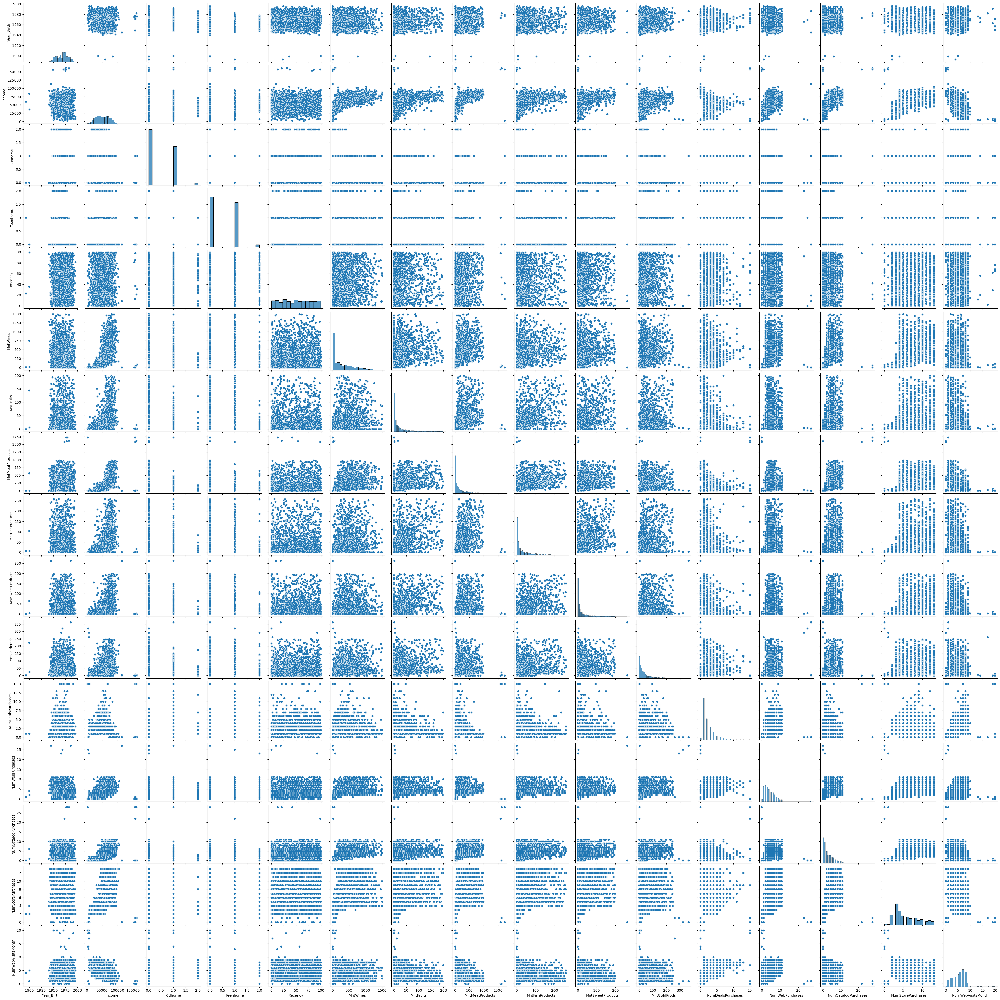

In [13]:
sns.pairplot(data_minus_75_percent_0)

In [14]:
data_no_dependents = data_minus_75_percent_0.drop(columns=['Kidhome', 'Teenhome'])

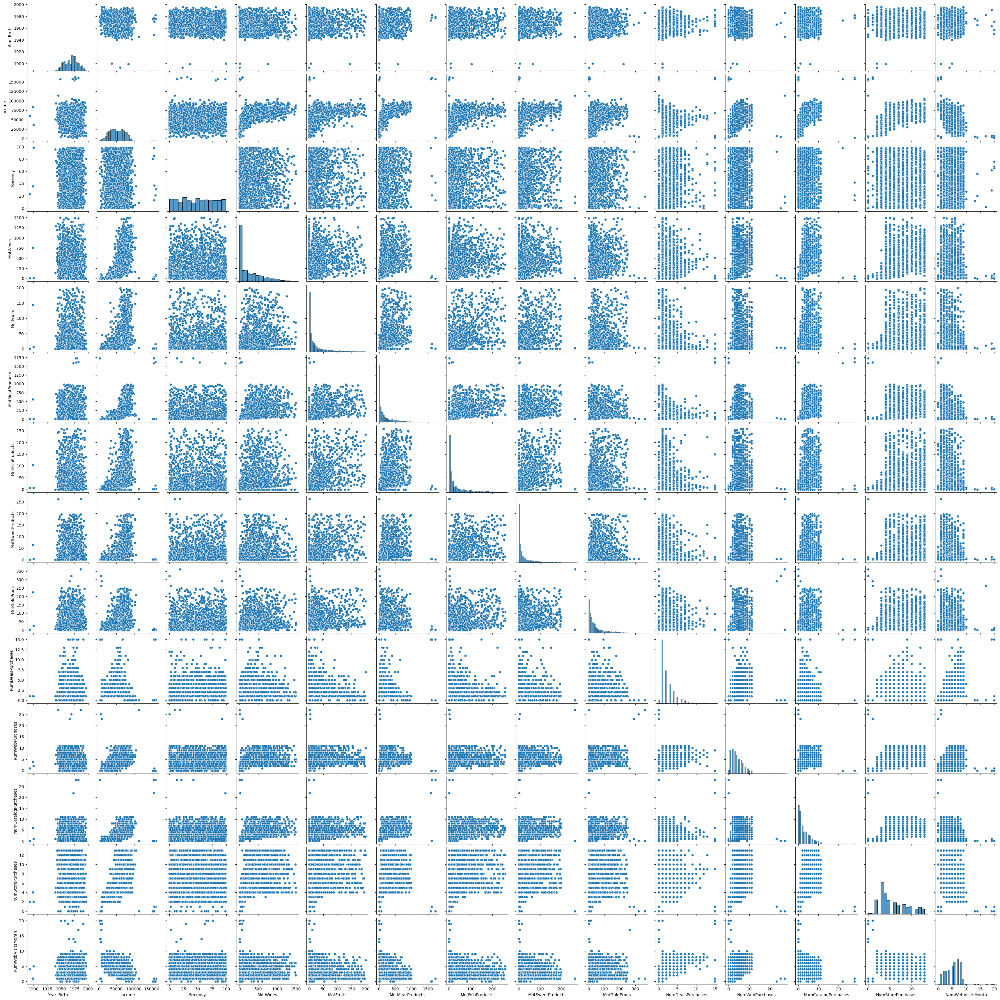

In [15]:
first_reduced_pairplot = sns.pairplot(data_no_dependents)
fig1 = first_reduced_pairplot.fig
fig1.savefig("first_reduced_pairplot.png")

In [16]:
data_no_dependents.isnull().sum()

Year_Birth              0
Education               0
Marital_Status          0
Income                 24
Dt_Customer             0
Recency                 0
MntWines                0
MntFruits               0
MntMeatProducts         0
MntFishProducts         0
MntSweetProducts        0
MntGoldProds            0
NumDealsPurchases       0
NumWebPurchases         0
NumCatalogPurchases     0
NumStorePurchases       0
NumWebVisitsMonth       0
dtype: int64

In [17]:
data_no_null = data_no_dependents.dropna()

In [18]:
data_no_null

,Year_Birth,Education,Marital_Status,Income,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth
0,1957,Graduation,Single,58138.0,04-09-2012,58,635,88,546,172,88,88,3,8,10,4,7
1,1954,Graduation,Single,46344.0,08-03-2014,38,11,1,6,2,1,6,2,1,1,2,5
2,1965,Graduation,Together,71613.0,21-08-2013,26,426,49,127,111,21,42,1,8,2,10,4
3,1984,Graduation,Together,26646.0,10-02-2014,26,11,4,20,10,3,5,2,2,0,4,6
4,1981,PhD,Married,58293.0,19-01-2014,94,173,43,118,46,27,15,5,5,3,6,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,1967,Graduation,Married,61223.0,13-06-2013,46,709,43,182,42,118,247,2,9,3,4,5
2236,1946,PhD,Together,64014.0,10-06-2014,56,406,0,30,0,0,8,7,8,2,5,7
2237,1981,Graduation,Divorced,56981.0,25-01-2014,91,908,48,217,32,12,24,1,2,3,13,6
2238,1956,Master,Together,69245.0,24-01-2014,8,428,30,214,80,30,61,2,6,5,10,3


In [19]:
raw_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2239 entries, 0 to 2239
Data columns (total 26 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Year_Birth           2239 non-null   int64  
 1   Education            2239 non-null   object 
 2   Marital_Status       2239 non-null   object 
 3   Income               2215 non-null   float64
 4   Kidhome              2239 non-null   int64  
 5   Teenhome             2239 non-null   int64  
 6   Dt_Customer          2239 non-null   object 
 7   Recency              2239 non-null   int64  
 8   MntWines             2239 non-null   int64  
 9   MntFruits            2239 non-null   int64  
 10  MntMeatProducts      2239 non-null   int64  
 11  MntFishProducts      2239 non-null   int64  
 12  MntSweetProducts     2239 non-null   int64  
 13  MntGoldProds         2239 non-null   int64  
 14  NumDealsPurchases    2239 non-null   int64  
 15  NumWebPurchases      2239 non-null   int64 

In [20]:
data_only_num = data_no_null.drop(columns=['Education', 'Marital_Status', 'Dt_Customer'])

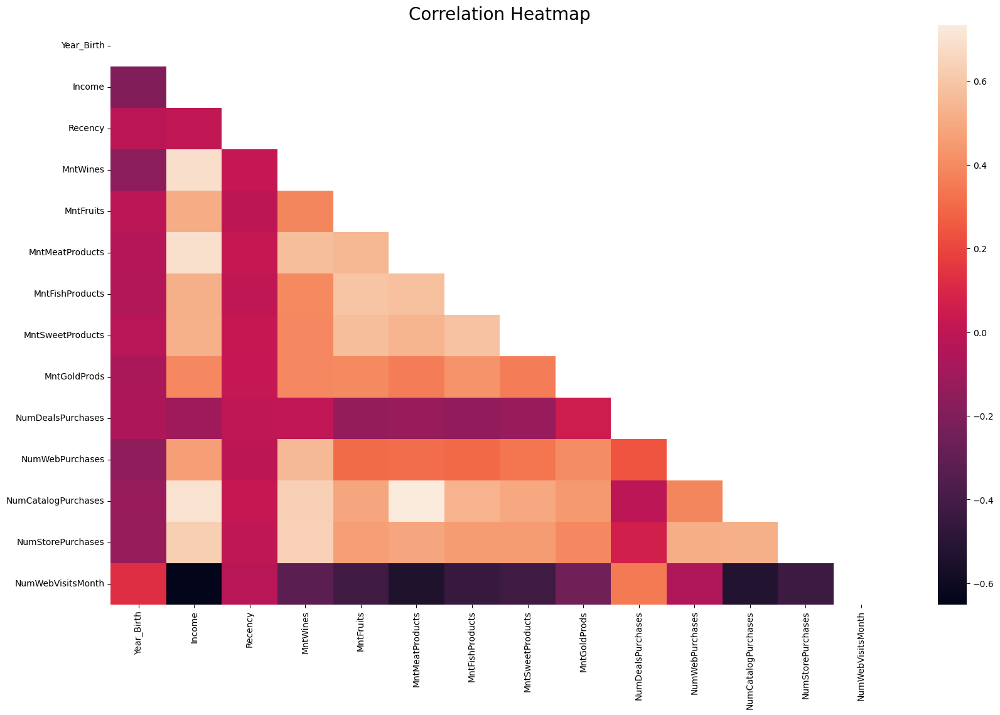

In [21]:
orig_corr = data_only_num.corr()
mask = np.triu(np.ones_like(orig_corr, dtype=bool))

plt2.figure(figsize=(20, 12))

sns.heatmap(orig_corr, mask=mask)

plt2.title('Correlation Heatmap', fontsize=20)
plt2.show()

In [22]:
standardized_df = pd.DataFrame(preprocessing.StandardScaler().fit_transform(data_only_num),columns = data_only_num.columns)
standardized_df.head()

,Year_Birth,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth
0,-0.986016,0.286604,0.310113,0.977779,1.548973,1.689714,2.453932,1.484340,0.849633,0.352088,1.428103,2.504074,-0.554500,0.693215
1,-1.236344,-0.261407,-0.380899,-0.872375,-0.637338,-0.718196,-0.651178,-0.634081,-0.733043,-0.167829,-1.125846,-0.571253,-1.169839,-0.131420
2,-0.318476,0.912723,-0.795506,0.358096,0.568903,-0.178646,1.339745,-0.147087,-0.038210,-0.687745,1.428103,-0.229550,1.291518,-0.543738
3,1.266933,-1.176680,-0.795506,-0.872375,-0.561948,-0.655768,-0.505056,-0.585381,-0.752344,-0.167829,-0.760996,-0.912956,-0.554500,0.280897
4,1.016605,0.293806,1.553934,-0.392047,0.418123,-0.218777,0.152497,-0.000989,-0.559335,1.391921,0.333553,0.112153,0.060839,-0.131420


C:\Users\alexi\anaconda3\envs\itcs_3162\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=9.
  warnings.warn(
C:\Users\alexi\anaconda3\envs\itcs_3162\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=9.
  warnings.warn(
C:\Users\alexi\anaconda3\envs\itcs_3162\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=9.
  warnings.warn(
C:\Users\alexi\anaconda3\envs\itcs_3162\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: 

Text(0, 0.5, 'Inertias')

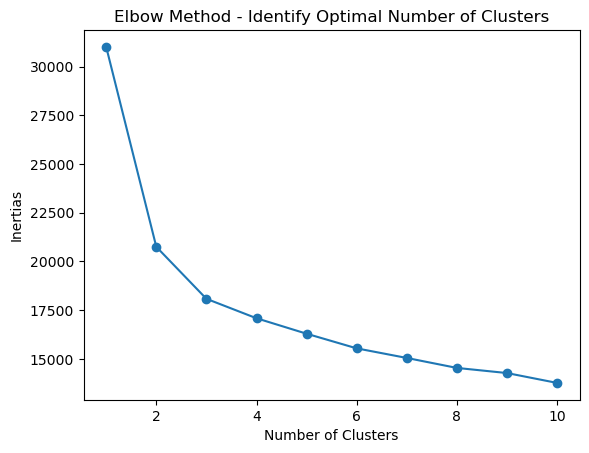

In [23]:
inertias = []

for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, random_state=42)
    clusters = kmeans.fit_predict(standardized_df)
    inertias.append(kmeans.inertia_)

plt2.plot(range(1,11), inertias, marker='o')
plt2.title('Elbow Method - Identify Optimal Number of Clusters')
plt2.xlabel('Number of Clusters')
plt2.ylabel('Inertias')

In [24]:
kmeans_1 = KMeans(n_clusters=3, random_state=42)

kmeans_1.fit(standardized_df)

standardized_df['Clusters'] = kmeans_1.predict(standardized_df)

C:\Users\alexi\anaconda3\envs\itcs_3162\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=9.
  warnings.warn(


In [25]:
standardized_df['Clusters'].value_counts()

Clusters
0    1009
1     610
2     596
Name: count, dtype: int64

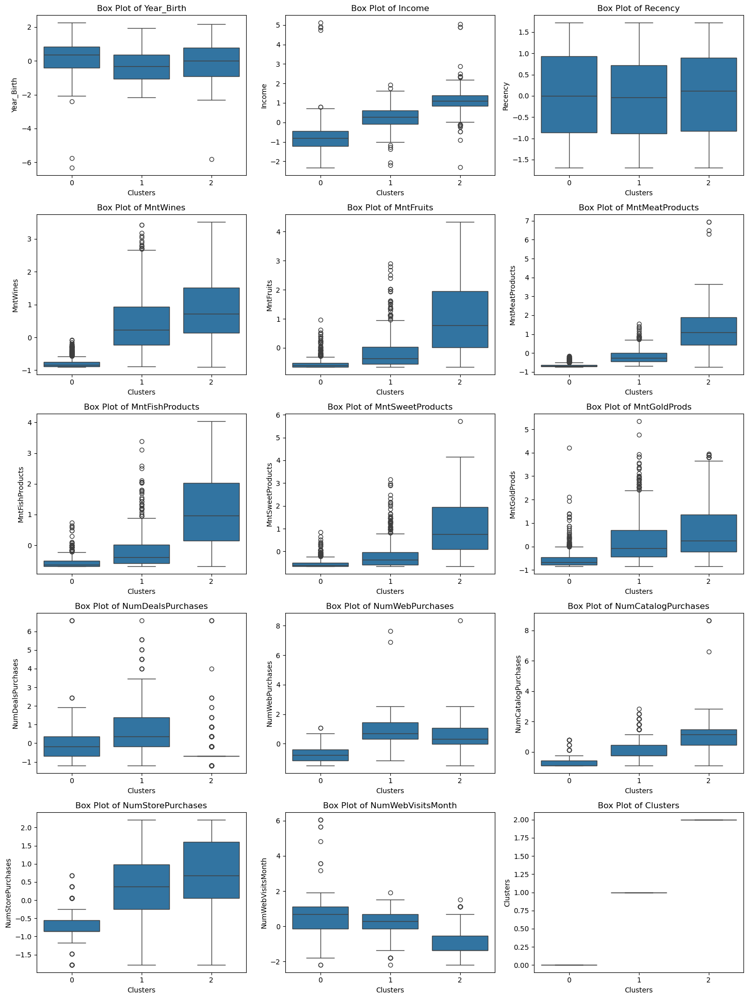

In [36]:
subset = ['MntWines', 'MntFruits', 'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts', 'MntGoldProds', 'NumWebPurchases', 'NumDealsPurchases', 'Income']
fig, axs = plt2.subplots(5, 3, figsize=(15,20))

axs = axs.flatten()

i = 0

for col in standardized_df.columns:
    sns.boxplot(data=standardized_df, y=col, x=standardized_df['Clusters'], ax=axs[i])
    axs[i].set_title(f'Box Plot of {col}')
    axs[i].set_ylabel(col)
    axs[i].set_xlabel('Clusters')
    i += 1

plt2.tight_layout()
new_fig = plt2.gcf()
new_fig.savefig("first_boxplots.png")
plt2.show()


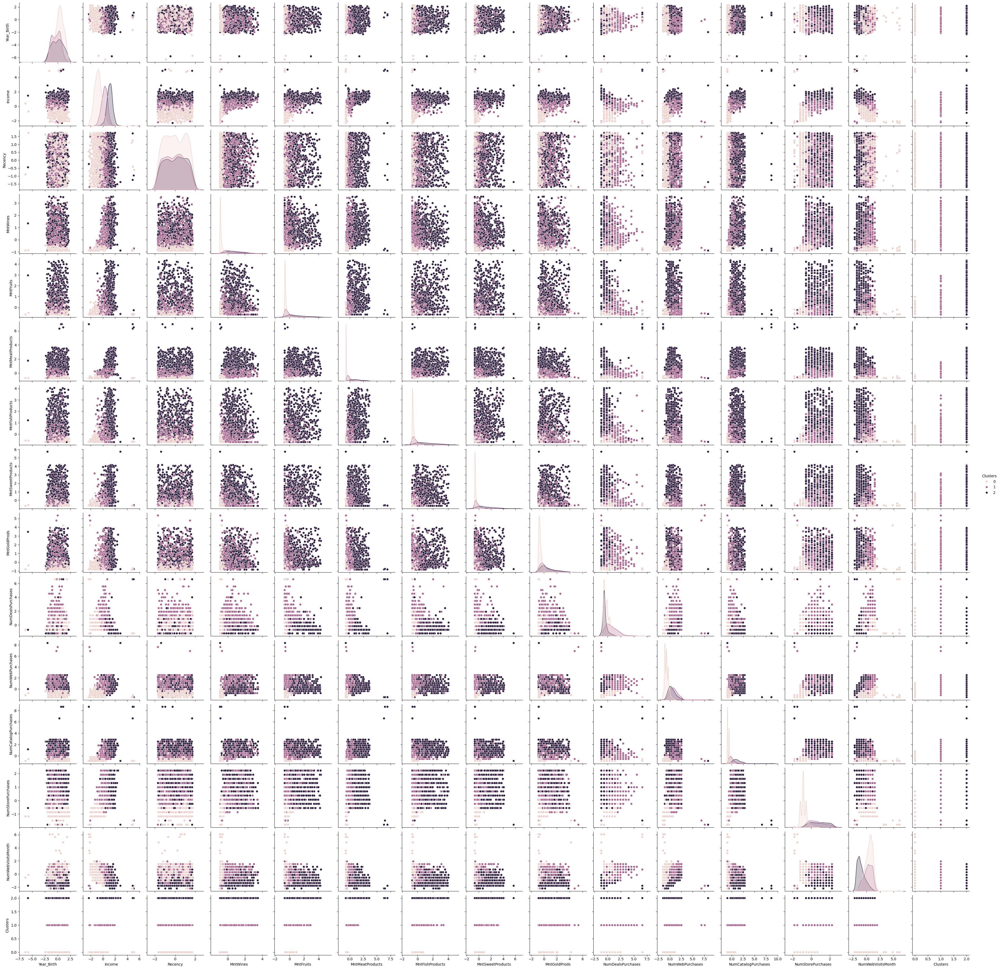

In [27]:
sns.pairplot(standardized_df, hue='Clusters', vars=standardized_df.columns)
plt2.show()

In [28]:
reduced_dataset = standardized_df.drop(columns=['Year_Birth', 'Income', 'Recency', 'Clusters'])

C:\Users\alexi\anaconda3\envs\itcs_3162\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=9.
  warnings.warn(
C:\Users\alexi\anaconda3\envs\itcs_3162\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=9.
  warnings.warn(
C:\Users\alexi\anaconda3\envs\itcs_3162\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=9.
  warnings.warn(
C:\Users\alexi\anaconda3\envs\itcs_3162\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: 

Text(0, 0.5, 'Inertias')

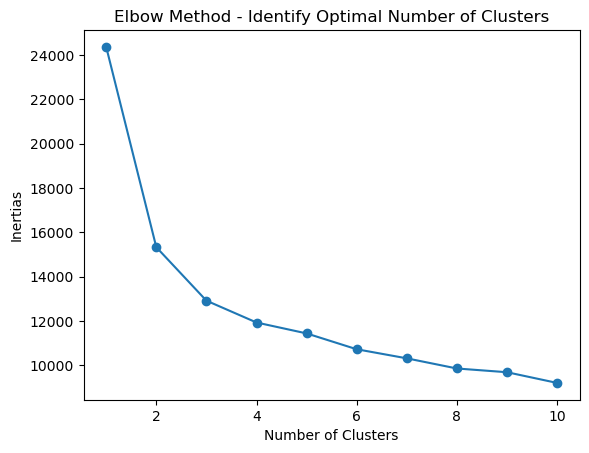

In [29]:
inertias2 = []

for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, random_state=42)
    clusters = kmeans.fit_predict(reduced_dataset)
    inertias2.append(kmeans.inertia_)

plt2.plot(range(1,11), inertias2, marker='o')
plt2.title('Elbow Method - Identify Optimal Number of Clusters')
plt2.xlabel('Number of Clusters')
plt2.ylabel('Inertias')

In [30]:
kmeans_2 = KMeans(n_clusters=3, random_state=42)

kmeans_2.fit(reduced_dataset)

reduced_dataset['Clusters'] = kmeans_2.predict(reduced_dataset)

C:\Users\alexi\anaconda3\envs\itcs_3162\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=9.
  warnings.warn(


In [31]:
reduced_dataset['Clusters'].value_counts()

Clusters
0    1059
1     586
2     570
Name: count, dtype: int64

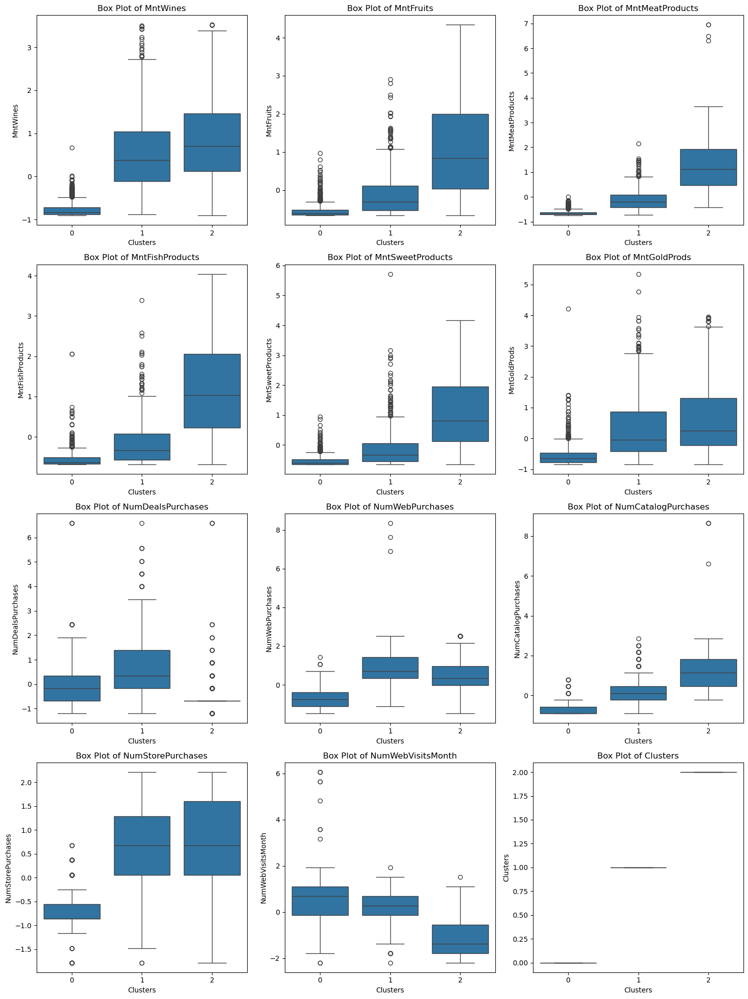

In [37]:
fig2, axs2 = plt2.subplots(4, 3, figsize=(15,20))

axs2 = axs2.flatten()

i = 0

for col in reduced_dataset.columns:
    sns.boxplot(data=reduced_dataset, y=col, x=reduced_dataset['Clusters'], ax=axs2[i])
    axs2[i].set_title(f'Box Plot of {col}')
    axs2[i].set_ylabel(col)
    axs2[i].set_xlabel('Clusters')
    i += 1

plt2.tight_layout()
second_boxplots = plt2.gcf()
second_boxplots.savefig("second_boxplots.png")
plt2.show()

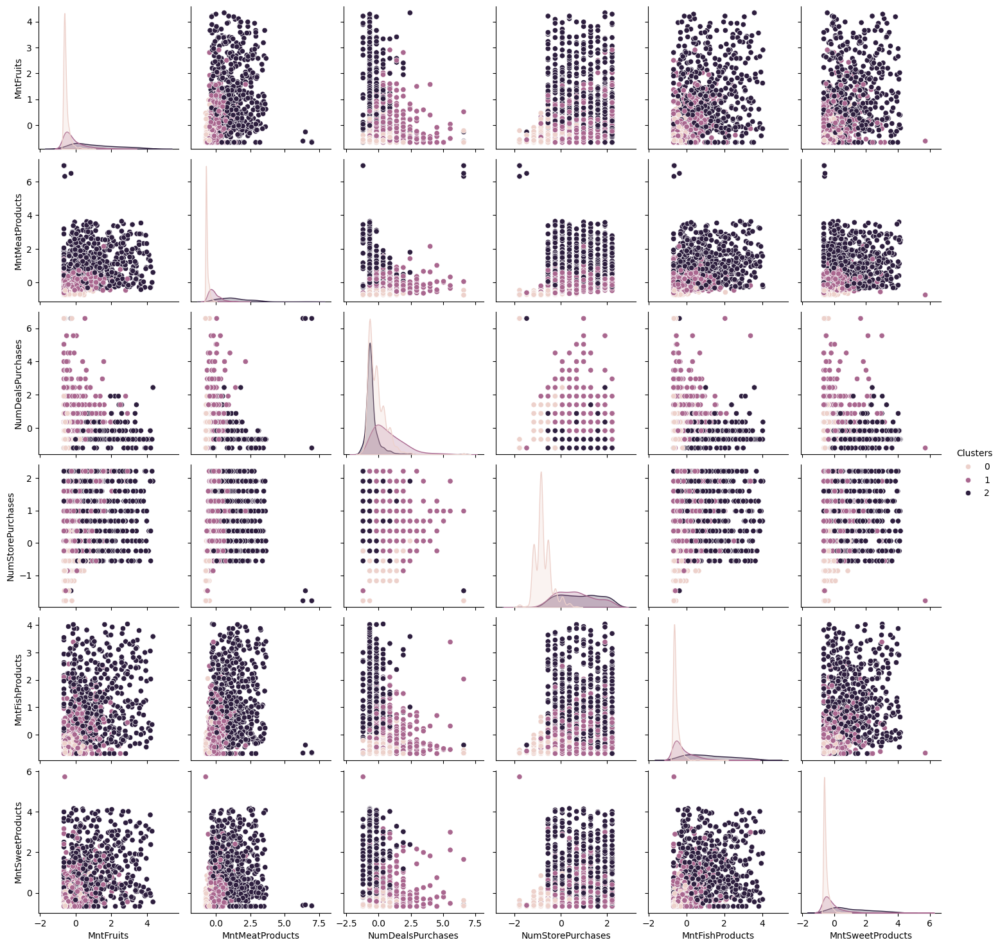

In [33]:
subset_cols = ['MntFruits','MntMeatProducts','NumDealsPurchases','NumStorePurchases','MntFishProducts','MntSweetProducts']
sns.pairplot(reduced_dataset, hue='Clusters', vars=subset_cols)
plt2.show()